# Breast Invasive Carcinoma (Broad, Nature 2012)

"Sequence analysis of mutations and translocations across
breast cancer subtypes" Baneriji et al. 

Whole-exome sequencing on 103 human breast cancer of diverse subtypes from patients in Mexico and Vietnamn was performed (54 patients from Mexico and 49 from Vietnam). 189,980 exons were targeted. This analysis revealed a total of 4,985 candidate somatic substitutions and insertions/deletions in the target protein-coding regions and the adjacent splice sites.
Six genes were found to be mutated with significant recurrence in the 103 whole-exome sequenced samples at a FDR<0.1, after correction for multiple hypothesis testing. One gene, CBFB is identified for the first time as a significantly mutated gene in breast cancer or any other epithelial cancer, to our knowledge, while the other 5 genes (TP53, PIK3CA, AKT1, GATA3, and MAP3K1) have previously been reported as mutated in breast cancer.

In [1]:
import os

In [2]:
os.chdir("C:/Users/Cristina/OneDrive/Documenti/BCG/Tesi/Datasets/Breast Invasive Carcinoma (Broad, Nature 2012)")

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import ydata_profiling as yp
from ydata_profiling import ProfileReport

## Patient clinical data

In [95]:
data_clinical_patient=pd.read_csv('data_clinical_patient.csv', sep=None, engine='python')
data_clinical_patient

,PATIENT_ID,SUBTYPE,AGE,COUNTRY,SEX,MENOPAUSE_STATUS,STAGE
0,BR-V-002,HER2,46,Vietnam,Female,Premenopausal,III
1,BR-V-003,NaN,60,Vietnam,Female,Postmenopausal,II
2,BR-V-007,Normal,38,Vietnam,Female,Premenopausal,III
3,BR-V-008,HER2,52,Vietnam,Female,Perimenopausal,III
4,BR-V-009,Luminal B,53,Vietnam,Female,Postmenopausal,III
...,...,...,...,...,...,...,...
98,BR-M-191,HER2,55,Mexico,Female,NaN,II
99,BR-M-192,Luminal A,59,Mexico,Female,NaN,III
100,BR-M-193,HER2,43,Mexico,Female,NaN,III
101,BR-M-198,Normal,44,Mexico,Female,NaN,II


In [96]:
profile_patient = ProfileReport(data_clinical_patient, title="Pandas Profiling Report")

In [27]:
profile_patient

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The observations (patients) are 103. The subtypes of the breast cancer are indicated (4.9% of missing values). The average age (i.e. the age at which a condition or disease was first diagnosed) of the patients is 51; the 52.4% come from Mexico, the 47.6% come from Vietnam. They are all females.
The menopause status (menopause is the permanent cessation of menses, usually defined by 6 to 12 months of amenorrhea) is indicated, but the 53.4% are missing values.
The tumor staging is present too (I, II, III): 70.9% of the patiets are in the II stage of the tumor. 

## Samples clinical data 

In [29]:
data_clinical_sample=pd.read_csv('data_clinical_sample.csv', sep=None, engine='python')
print(data_clinical_sample)

    PATIENT_ID SAMPLE_ID           CANCER_TYPE_DETAILED ONCOTREE_CODE  \
0     BR-V-002  BR-V-002  Infiltrating Ductal Carcinoma           IDC   
1     BR-V-003  BR-V-003  Infiltrating Ductal Carcinoma           IDC   
2     BR-V-007  BR-V-007  Infiltrating Ductal Carcinoma           IDC   
3     BR-V-008  BR-V-008  Infiltrating Ductal Carcinoma           IDC   
4     BR-V-009  BR-V-009  Infiltrating Ductal Carcinoma           IDC   
..         ...       ...                            ...           ...   
98    BR-M-191  BR-M-191  Infiltrating Ductal Carcinoma           IDC   
99    BR-M-192  BR-M-192  Infiltrating Ductal Carcinoma           IDC   
100   BR-M-193  BR-M-193  Infiltrating Ductal Carcinoma           IDC   
101   BR-M-198  BR-M-198  Infiltrating Ductal Carcinoma           IDC   
102   BR-M-200  BR-M-200  Infiltrating Ductal Carcinoma           IDC   

    HER2_STATUS HER2_AMPLIFICATION_STATUS ER_STATUS GRADE PR_STATUS  PURITY  \
0           NaN                       Yes  N

In [30]:
profile_sample = ProfileReport(data_clinical_sample, title="Pandas Profiling Report")

In [31]:
profile_sample

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

For each sample, the cancer type detailed is specified (79.6% of the samples are of Infiltrating Ductal Carcinoma type).
ONCOTREE_CODE variable is a redundant variable.
HER2 status is indicated, but 46.6% of the values are missing.
HER2 amplification status (1.9% of missing values) represents the over-expression of HER2: it is associated with poorer overall survival in breast cancer. The 67% of the samples have not an amplified HER2 status.
The endocrine and progesterone receptor status are present (both have 30.1% of missing values) and most of them are positive.
The tumor grade is present (42.7% of missing values): it expresses the degree of abnormality of cancer cells, a measure of differentation and aggressiveness. 
There are also purity and ploidy variables (both have 14.6% of missing values). Ploidy shows that diploid cells carry a DNA index of 1, whereas hyperdiploid cells have a DNA index greater than 1. The average ploidy of the samples is 2.47, showing that most of the samples are hyperdiploid (hyperdiploid tumor cells are significantly larger and more metabolically active than euploid cancer cells). 
The non silent and silent rate are present in the dataset, with a mean value, respectively of 1.24 and 0.38.

In [32]:
# keep only the relevant variables: ONCOTREE_CODE, CANCER_TYPE, TMB_NONSYNONYMOUS are discarded 
data_clinical_sample_relevant=data_clinical_sample.drop(['ONCOTREE_CODE', 'CANCER_TYPE', 'SOMATIC_STATUS'],axis=1)

#### Select ductal TNBC patients 

In [33]:
# ductal carcinoma patients 
ductal_pts = data_clinical_sample.loc[data_clinical_sample['ONCOTREE_CODE'].isin(['IDC','DCIS'])]                                

In [34]:
ductal_pts = ductal_pts[['PATIENT_ID']]

#### Select TNBC patients 

In [35]:
# triple negative patients
TN_pts=data_clinical_sample_relevant.loc[(data_clinical_sample_relevant['ER_STATUS']=='Negative')&(data_clinical_sample_relevant['PR_STATUS']=='Negative')&(data_clinical_sample_relevant['HER2_STATUS']=='Negative')]
TN_pts

,PATIENT_ID,SAMPLE_ID,CANCER_TYPE_DETAILED,HER2_STATUS,HER2_AMPLIFICATION_STATUS,ER_STATUS,GRADE,PR_STATUS,PURITY,PLOIDY,SILENT_RATE,NONSILENT_RATE,TMB_NONSYNONYMOUS
59,BR-M-045,BR-M-045,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,0.56,2.67,1.27,3.57,333.333.333.333
69,BR-M-080,BR-M-080,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.17,0.52,0.466666666667
72,BR-M-094,BR-M-094,Mixed Carcinoma,Negative,No,Negative,NaN,Negative,0.35,1.89,0.14,0.65,126.666.666.667
81,BR-M-122,BR-M-122,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.39,1.22,103.333.333.333
94,BR-M-174,BR-M-174,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.72,1.74,173.333.333.333
97,BR-M-189,BR-M-189,Medullary Breast Carcinoma,Negative,No,Negative,NaN,Negative,0.29,2.93,0.58,1.73,156.666.666.667


In [36]:
# select patients both TN and IDC
TN_ductal_pts = pd.merge(ductal_pts, TN_pts, how='inner', on=['PATIENT_ID'])
TN_ductal_pts

,PATIENT_ID,SAMPLE_ID,CANCER_TYPE_DETAILED,HER2_STATUS,HER2_AMPLIFICATION_STATUS,ER_STATUS,GRADE,PR_STATUS,PURITY,PLOIDY,SILENT_RATE,NONSILENT_RATE,TMB_NONSYNONYMOUS
0,BR-M-045,BR-M-045,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,0.56,2.67,1.27,3.57,333.333.333.333
1,BR-M-080,BR-M-080,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.17,0.52,0.466666666667
2,BR-M-122,BR-M-122,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.39,1.22,103.333.333.333
3,BR-M-174,BR-M-174,Infiltrating Ductal Carcinoma,Negative,No,Negative,III,Negative,NaN,NaN,0.72,1.74,173.333.333.333


In [37]:
TN_ductal_pts=TN_ductal_pts[['PATIENT_ID']]
TN_ductal_pts

,PATIENT_ID
0,BR-M-045
1,BR-M-080
2,BR-M-122
3,BR-M-174


#### Select ductal non-TNBC patients

In [38]:
# select the IDC patients not TN
x = pd.concat([TN_ductal_pts, ductal_pts])
ductal_NON_TN_pts = x.drop_duplicates(keep=False, inplace=False)
ductal_NON_TN_pts

,PATIENT_ID
0,BR-V-002
1,BR-V-003
2,BR-V-007
3,BR-V-008
4,BR-V-009
...,...
98,BR-M-191
99,BR-M-192
100,BR-M-193
101,BR-M-198


## Mutational data 

In [39]:
data_mutation=pd.read_csv('data_mutations_final.csv', sep=None, engine='python')
print(data_mutation)

     Hugo_Symbol  Entrez_Gene_Id         Center NCBI_Build Chromosome  \
0          ACTN3               0  broad.mit.edu     GRCh37         11   
1        ADAMTS7               0  broad.mit.edu     GRCh37         15   
2        CACNA1E               0  broad.mit.edu     GRCh37          1   
3        CEACAM8               0  broad.mit.edu     GRCh37         19   
4            CFH               0  broad.mit.edu     GRCh37          1   
...          ...             ...            ...        ...        ...   
4980       ZMYM1               0  broad.mit.edu     GRCh37          1   
4981      ZNF264               0  broad.mit.edu     GRCh37         19   
4982      ZNF331               0  broad.mit.edu     GRCh37         19   
4983      ZNF404               0  broad.mit.edu     GRCh37         19   
4984      ZNF423               0  broad.mit.edu     GRCh37         16   

      Start_Position  End_Position Strand  \
0           66318756      66318756      +   
1           79059041      7905904

In [40]:
profile_mutation = ProfileReport(data_mutation, title="Pandas Profiling Report")

In [41]:
profile_mutation

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The MAF file contains 4985 observations (rows) and 153 variables (columns). The mutated distinct genes are 3809.
Entrez_Gene_Id variable is not present. 
The reference genome used for the alignment (NCBI_Build) is GRCh37 for all the observations.
All the 23 chromosomes harbor mutations, even the sexual chromosome X. **For SNPs, the Start_Position=End_Position.** The 62.1% of the mutations are missense and they are for the 93.3% SNPs.
Tumor_Seq_Allele1 variable does not have values. 
All the mutations are somatic (100%).
Protein position variables has 4.2% of missing values (208 samples).
BIOTYPE variable indicates that most of the mutated genes (99.5%) are protein coding.
It is also indicated whether the mutation is homozygous or not (68.6% are not). 

In [42]:
# select the relevant variables from the MAF file
data_mutation_final=data_mutation[['Tumor_Sample_Barcode', 'Hugo_Symbol', 'Chromosome', 'Start_Position', 'End_Position', 'Variant_Classification', 'Variant_Type', 'Reference_Allele', 'Tumor_Seq_Allele1','Tumor_Seq_Allele2', 'Match_Norm_Seq_Allele1', 'Match_Norm_Seq_Allele2', 'HGVSc', 'HGVSp_Short', 'Protein_position', 'CDS_position', 'IMPACT', 'cDNA_position', 'SWISSPROT','Transcript_ID', 'ENSP']]

In this dataset sample IDs and patient IDs are equal.

In [43]:
patient_sample=data_clinical_sample.iloc[:,0:2]

#### Associate the patient IDs to the mutation dataset

In [44]:
# adding the patient_ID to the mutation dataset 
data_mutation_sample_pts = data_mutation_final.join(patient_sample.set_index('SAMPLE_ID'), on='Tumor_Sample_Barcode')

In [45]:
data_mutation_sample_pts=data_mutation_sample_pts[['Tumor_Sample_Barcode', 'PATIENT_ID', 'Hugo_Symbol', 'Chromosome', 'Start_Position', 'End_Position', 'Variant_Classification', 'Variant_Type', 'Reference_Allele','Tumor_Seq_Allele1', 'Tumor_Seq_Allele2', 'Match_Norm_Seq_Allele1', 'Match_Norm_Seq_Allele2', 'HGVSc', 'HGVSp_Short', 'Protein_position', 'CDS_position', 'IMPACT', 'cDNA_position', 'SWISSPROT','Transcript_ID', 'ENSP']]

In [46]:
data_mutation_sample_pts=data_mutation_sample_pts[['Tumor_Sample_Barcode', 'PATIENT_ID','Hugo_Symbol', 'Chromosome', 'Start_Position', 'End_Position', 'Variant_Classification', 'Variant_Type', 'Reference_Allele', 'Tumor_Seq_Allele1', 'Tumor_Seq_Allele2', 'HGVSc', 'HGVSp_Short', 'Protein_position','Transcript_ID', 'ENSP']].copy()

In [47]:
data_mutation_sample_pts.to_csv('mutation_table_Banerji_et_al_Nature_2012.csv')

In [48]:
# reload the dataset with the addition of the gene length
data_mutation_sample_pts= pd.read_csv('mutation_table_Banerji_et_al_Nature_2012_FINAL.csv', sep=None, engine='python')
data_mutation_sample_pts = data_mutation_sample_pts.iloc[:, 1:]

In [49]:
# select the unique mutated patients 
mutated_pts = data_mutation_sample_pts['PATIENT_ID'].unique()
mutated_pts = pd.DataFrame(mutated_pts, columns = ['PATIENT_ID'])

In [50]:
# select the mutated TN ductal carcinoma patients 
mutated_TN_ductal_pts = pd.merge(TN_ductal_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

There are just 4 mutated triple-negative ductal carcinoma patients. 

In [51]:
data_mutation_TN_ductal_pts = pd.merge(TN_ductal_pts, data_mutation_sample_pts, how='inner', on=['PATIENT_ID'])

In [52]:
data_mutation_TN_ductal_pts['PATIENT_ID'].nunique()

4

In [53]:
# save the dataset 
data_mutation_TN_ductal_pts.to_csv('mutation_table_Banerji_et_al_Broad_Nature2012_TN_ductal.csv')

In [54]:
# select the IDC non TN patients
mutated_ductal_NON_TN_pts = pd.merge(ductal_NON_TN_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

In [55]:
data_mutation_NON_TN_ductal_pts = pd.merge(ductal_NON_TN_pts, data_mutation_sample_pts, how='inner', on=['PATIENT_ID'])

In [56]:
data_mutation_NON_TN_ductal_pts['PATIENT_ID'].nunique()

87

In [57]:
# save the dataset 
data_mutation_NON_TN_ductal_pts.to_csv('mutation_table_Banerji_et_al_Broad_Nature2012_NON_TN_ductal.csv')

In [58]:
# select the total ductal carcinoma mutated patients 
total_mutated_ductal_pts = pd.merge(ductal_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

In [59]:
data_mutation_TOTAL_ductal_pts = pd.merge(total_mutated_ductal_pts, data_mutation_sample_pts, how='inner', on=['PATIENT_ID'])

In [60]:
data_mutation_TOTAL_ductal_pts['PATIENT_ID'].nunique()

91

In [61]:
# save the dataset 
data_mutation_TOTAL_ductal_pts.to_csv('mutation_table_Banerji_et_al_Broad_Nature2012_TOTAL_ductal.csv')

### Mutation Rate analysis

In [62]:
# add a column to the dataset representing the mutated bases length (End_Position-Start_Position+1)
data_mutation_sample_pts.loc[:, 'Mutation_length'] = data_mutation_sample_pts['End_Position']-data_mutation_sample_pts['Start_Position']+1

In [63]:
data_mutation_sample_pts['PATIENT_ID'].nunique()

103

There are 103 patients.

In [64]:
# extract PATIENT_ID and Mutation_length
pts_mutation_length = data_mutation_sample_pts[['PATIENT_ID', 'Mutation_length']]

In [65]:
# group by PATIENT_ID and sum the mutation lengths for each pts
mutation_Banerji_et_al_group_by_pts=pts_mutation_length.groupby(['PATIENT_ID'])['Mutation_length'].sum().reset_index()
mutation_Banerji_et_al_group_by_pts.rename(columns = {'Mutation_length':'Total_sum_mutated_bases'}, inplace = True)

In [66]:
# extract Hugo_Symbol and Gene_length
gene_length_for_each_mutation = data_mutation_sample_pts[['Hugo_Symbol', 'Gene_length']]

In [67]:
# look at the number of distinct genes
gene_length_for_each_mutation['Hugo_Symbol'].nunique()

3811

In [68]:
# group by gene (Hugo_Symbol) 
mutation_Banerji_et_al_group_by_gene=gene_length_for_each_mutation.groupby(['Hugo_Symbol'])['Gene_length'].max().reset_index()

In [69]:
# compute the total gene length (for all the genes in the dataset)
total_GeneLength = mutation_Banerji_et_al_group_by_gene['Gene_length'].sum()

In [70]:
# add a column to the dataset representing the mutation rate for each patient (Mutation_rate= Mutation_length/total_gene_length)
mutation_Banerji_et_al_group_by_pts["Mutation_rate"] = mutation_Banerji_et_al_group_by_pts["Total_sum_mutated_bases"]/total_GeneLength

In [71]:
# multiply the Mutation_rate values times 10^6
mutation_Banerji_et_al_group_by_pts["Mutation_rate*10^6"] = mutation_Banerji_et_al_group_by_pts["Mutation_rate"]*1000000

In [72]:
# the PATIENT_IDs are sorted for descending order of mutation rate 
mutation_Banerji_et_al_group_by_pts = mutation_Banerji_et_al_group_by_pts.sort_values(by="Mutation_rate", ascending=False)

In [73]:
patient_mutation_rate=mutation_Banerji_et_al_group_by_pts[['PATIENT_ID', 'Mutation_rate*10^6' ]]

In [74]:
patients=np.arange(0,103,1)
# convert a series into a Numpy array
mutation_rate=mutation_Banerji_et_al_group_by_pts[['Mutation_rate*10^6']].to_numpy()

<IPython.core.display.Javascript object>


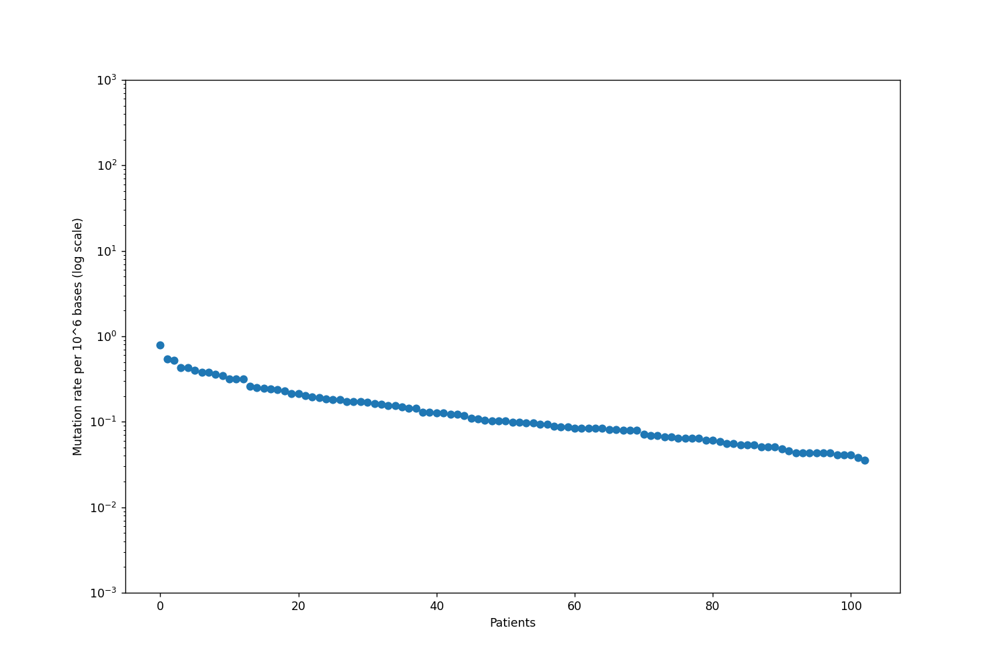

In [75]:
%matplotlib notebook
plt.rcParams['figure.figsize'] = (12, 8)
plt.yscale("log") 
#set axes limit
plt.ylim(0.001, 1000)
plt.scatter(patients, mutation_rate)
plt.xlabel("Patients")
plt.ylabel("Mutation rate per 10^6 bases (log scale)")
plt.show()

### Mutation Frequency analysis 

In [76]:
genes_patients=data_mutation_sample_pts[['PATIENT_ID', 'Hugo_Symbol']]

In [77]:
n_of_pts_per_gene = genes_patients.groupby(['Hugo_Symbol'])['PATIENT_ID'].count().reset_index()
n_of_pts_per_gene.rename(columns = {'PATIENT_ID':'Num_pts_per_gene'}, inplace = True)

In [78]:
# the total number of patients is 103 
tot_pts = 103 

In [79]:
# add a column to the n_of_pts_per_gene dataframe representing the mutation frequency for each gene
n_of_pts_per_gene["Mutation_frequency (%)"] = (n_of_pts_per_gene["Num_pts_per_gene"]*100)/tot_pts

In [80]:
# the numbers of patients per gene are sorted in descending order
n_of_pts_per_gene = n_of_pts_per_gene.sort_values(by="Num_pts_per_gene", ascending=False)

In [81]:
gene_mutation_frequency = n_of_pts_per_gene[['Hugo_Symbol', 'Mutation_frequency (%)']]

In [82]:
# select the first 50 genes
highest_mutated_genes=gene_mutation_frequency.head(50)

In [83]:
mutated_gene_names=highest_mutated_genes['Hugo_Symbol'].tolist()

<IPython.core.display.Javascript object>


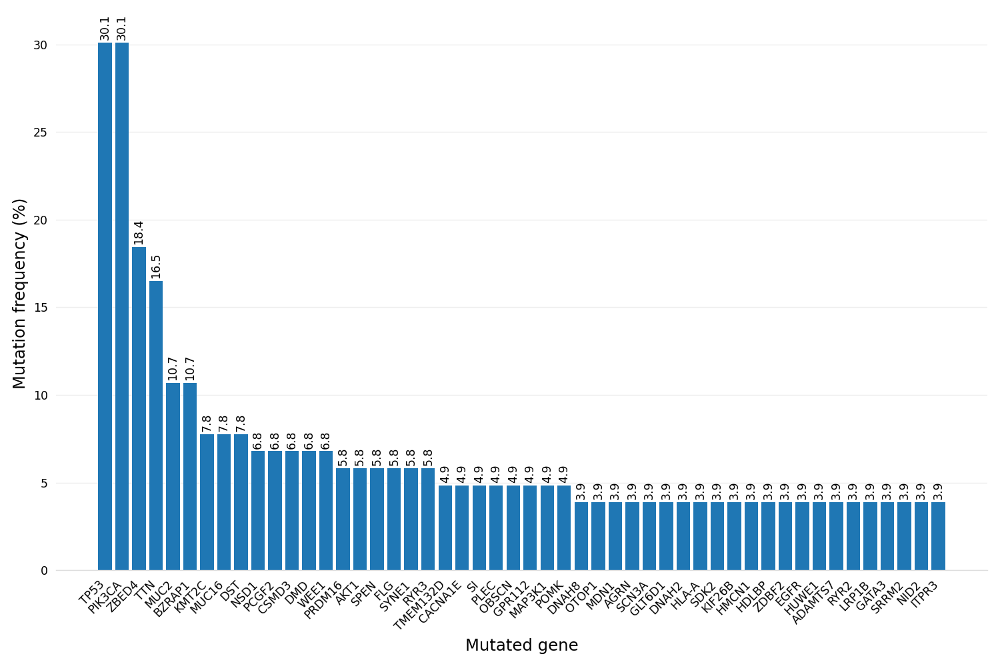

In [84]:
# increase the quality and resolution of the chart
from IPython.display import set_matplotlib_formats
import matplotlib_inline.backend_inline

matplotlib_inline.backend_inline.set_matplotlib_formats('retina')
# set default figure size.
plt.rcParams['figure.figsize'] = (12, 8)
fig, ax = plt.subplots()
h=ax.bar(highest_mutated_genes['Hugo_Symbol'], highest_mutated_genes['Mutation_frequency (%)'], label=mutated_gene_names)
xticks_pos = [0.65*patch.get_width() + patch.get_xy()[0] for patch in h]

_ = plt.xticks(xticks_pos, mutated_gene_names,  ha='right', rotation=45)
#plt.title('Highest mutated genes', fontsize=14)
plt.xlabel('Mutated gene', fontsize=14)
plt.ylabel('Mutation frequency (%)', fontsize=14)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

# Add text annotations to the top of the bars.
# Note, you'll have to adjust this slightly (the 0.3)
# with different data.
for bar in h:
  ax.text(
      bar.get_x() + bar.get_width() / 2,
      bar.get_height() + 0.3,
      round(bar.get_height(), 1),
      rotation='vertical',
      horizontalalignment='center'
  )


fig.tight_layout()

### Normalized Mutation Frequency analysis

In [85]:
# adding the gene length to the gene_mutation_frequency dataset 
gene_mutation_frequency_gene_length = gene_mutation_frequency.join(mutation_Banerji_et_al_group_by_gene.set_index('Hugo_Symbol'), on='Hugo_Symbol')

In [86]:
# add a column to the gene_mutation_frequency_gene_length dataframe representing the mutation frequency for each gene, that is normalized based on the gene length
gene_mutation_frequency_gene_length["Normalized mutation frequency per 10^6"] = ((n_of_pts_per_gene["Num_pts_per_gene"])/(tot_pts*gene_mutation_frequency_gene_length["Gene_length"]))*1000000

In [87]:
gene_normalized_mutation_frequency = gene_mutation_frequency_gene_length[['Hugo_Symbol', 'Normalized mutation frequency per 10^6']]

In [88]:
# the Normalized mutation frequency per gene is sorted in descending order
gene_normalized_mutation_frequency = gene_normalized_mutation_frequency.sort_values(by="Normalized mutation frequency per 10^6", ascending=False)

In [89]:
# select the first 50 genes
highest_mutated_genes_normalized_frequency=gene_normalized_mutation_frequency.head(50)

In [90]:
mutated_gene_names=highest_mutated_genes_normalized_frequency['Hugo_Symbol'].tolist()

<IPython.core.display.Javascript object>


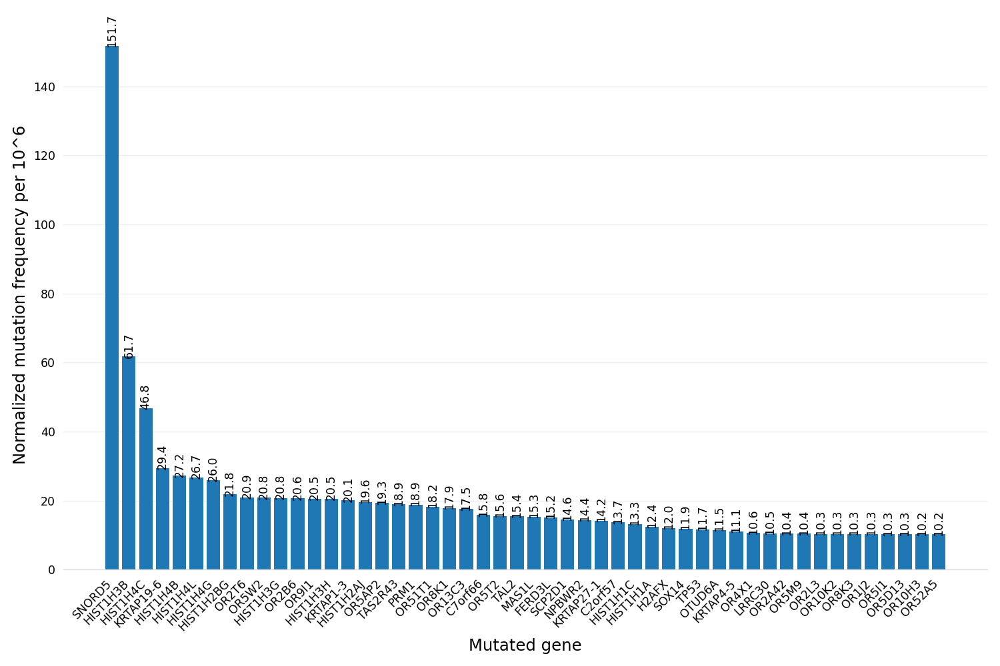

In [91]:
# increase the quality and resolution of the chart
from IPython.display import set_matplotlib_formats
import matplotlib_inline.backend_inline

matplotlib_inline.backend_inline.set_matplotlib_formats('retina')
# set default figure size.
plt.rcParams['figure.figsize'] = (12, 8)
fig, ax = plt.subplots()
h=ax.bar(highest_mutated_genes_normalized_frequency['Hugo_Symbol'], highest_mutated_genes_normalized_frequency['Normalized mutation frequency per 10^6'], label=mutated_gene_names)
xticks_pos = [0.65*patch.get_width() + patch.get_xy()[0] for patch in h]

_ = plt.xticks(xticks_pos, mutated_gene_names,  ha='right', rotation=45)
#plt.title('Highest mutated genes', fontsize=14)
plt.xlabel('Mutated gene', fontsize=14)
plt.ylabel('Normalized mutation frequency per 10^6', fontsize=14)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

# Add text annotations to the top of the bars.
# Note, you'll have to adjust this slightly (the 0.3)
# with different data.
for bar in h:
  ax.text(
      bar.get_x() + bar.get_width() / 2,
      bar.get_height() + 0.3,
      round(bar.get_height(), 1),
      rotation='vertical',
      horizontalalignment='center'
  )


fig.tight_layout()